In [1]:
import numpy as np
import copy
from astropy.io import fits
from importlib import reload
import matplotlib.pyplot as plt
plt.rcParams['image.origin']='lower'
import os
from pathlib import Path
from datetime import datetime
date = int(datetime.today().strftime('%Y%m%d'))

import proper
proper.use_ffti = False
proper.use_fftw = False

import roman_phasec_proper as phasec
phasec.copy_here()
import falco

from IPython.display import clear_output, display, HTML
display(HTML("<style>.container { width:90% !important; }</style>")) # just making the notebook cells wider

falco_dir = Path(os.path.dirname(falco.__file__))
roman_dir = Path(os.path.dirname(falco_dir))/'roman'
flatmap_dir = roman_dir/'flatmaps'

import misc
from imshows import *

import falco_spc_wfov_825_mp
import phase_retrieval as pr

In [2]:
reload(falco_spc_wfov_825_mp)
mp = falco_spc_wfov_825_mp.setup_mp(Nitr=10, estimator='perfect')

/home/u21/kianmilani/Documents/falco-python/falco/config


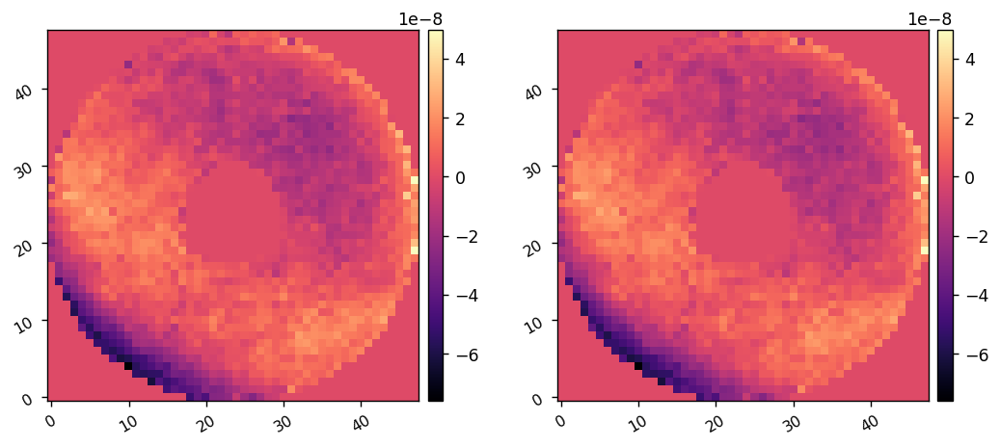

In [3]:
dm1_flat_fpath = Path('~/roman_phasec_v1.4/python/roman_phasec_proper/examples/spc_wide_band4_flattened_dm1.fits')
dm2_flat_fpath = Path('~/roman_phasec_v1.4/python/roman_phasec_proper/examples/spc_wide_band4_flattened_dm2.fits')

dm1_flat_proper = fits.getdata(dm1_flat_fpath)
dm2_flat_proper = fits.getdata(dm2_flat_fpath)

imshow2(dm1_flat_proper, dm2_flat_proper)

In [10]:
# fn_dm1_flatmap = os.path.join(flatmap_path, 'dm1_m_spc-wide_band4.fits')
#     fn_dm2_flatmap = os.path.join(flatmap_path, 'dm2_m_spc-wide_band4.fits')
#     fn_dm1_flatmapNoSPM = os.path.join(flatmap_path, 'dm1_m_flat_hlc_band4.fits')
#     fn_dm2_flatmapNoSPM = os.path.join(flatmap_path, 'dm2_m_flat_hlc_band4.fits')
#     mp.full.dm1 = falco.config.Object()
#     mp.full.dm2 = falco.config.Object()
#     mp.full.dm1.flatmap = fits.getdata(fn_dm1_flatmap)
#     mp.full.dm2.flatmap = fits.getdata(fn_dm2_flatmap)
#     mp.full.dm1.flatmapNoSPM = fits.getdata(fn_dm1_flatmapNoSPM)
#     mp.full.dm2.flatmapNoSPM = fits.getdata(fn_dm2_flatmapNoSPM)

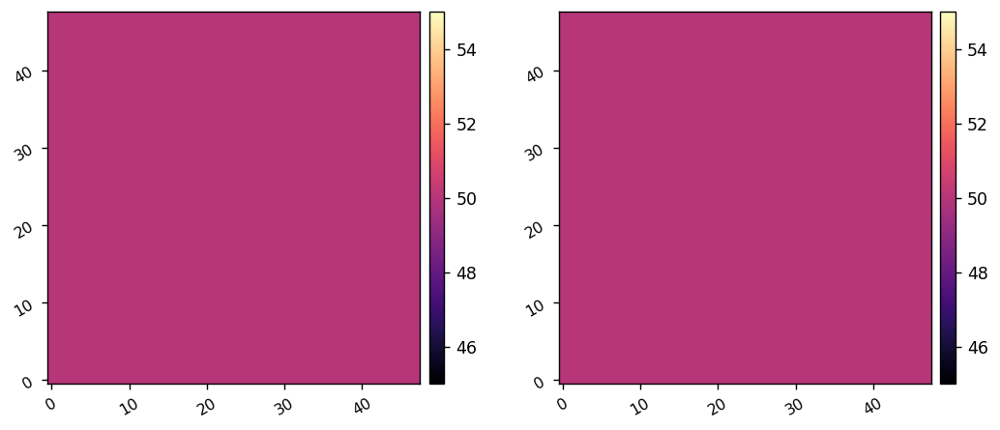

In [3]:
# DM starting voltages (in the PROPER model only)
# fn_dm1_flatmap = os.path.join(str(flatmap_dir), 'dm1_m_spc-wide_band4.fits')
# fn_dm2_flatmap = os.path.join(str(flatmap_dir), 'dm2_m_spc-wide_band4.fits')
# fn_dm1_flatmap_noSPM = os.path.join(str(flatmap_dir), 'dm1_m_flat_hlc_band4.fits')
# fn_dm2_flatmap_noSPM = os.path.join(str(flatmap_dir), 'dm2_m_flat_hlc_band4.fits')

# dm1_flatmap = fits.getdata(fn_dm1_flatmap)
# dm2_flatmap = fits.getdata(fn_dm2_flatmap)
# imshow2(dm1_flatmap, dm2_flatmap)

# dm1_flatmap_noSPM = fits.getdata(fn_dm1_flatmap_noSPM)
# dm2_flatmap_noSPM = fits.getdata(fn_dm2_flatmap_noSPM)
# imshow2(dm1_flatmap_noSPM, dm2_flatmap_noSPM)

# mp.full.dm1 = falco.config.Object()
# mp.full.dm2 = falco.config.Object()

# mp.full.dm1.flatmap = dm1_flatmap
# mp.full.dm2.flatmap = dm2_flatmap

# mp.full.dm1.flatmapNoSPM = dm1_flatmap_noSPM
# mp.full.dm2.flatmapNoSPM = dm2_flatmap_noSPM

# mp.dm1.biasMap = 50 + mp.full.dm1.flatmap/mp.dm1.VtoH
# mp.dm2.biasMap = 50 + mp.full.dm2.flatmap/mp.dm2.VtoH
# imshow2(mp.dm1.biasMap, mp.dm2.biasMap)


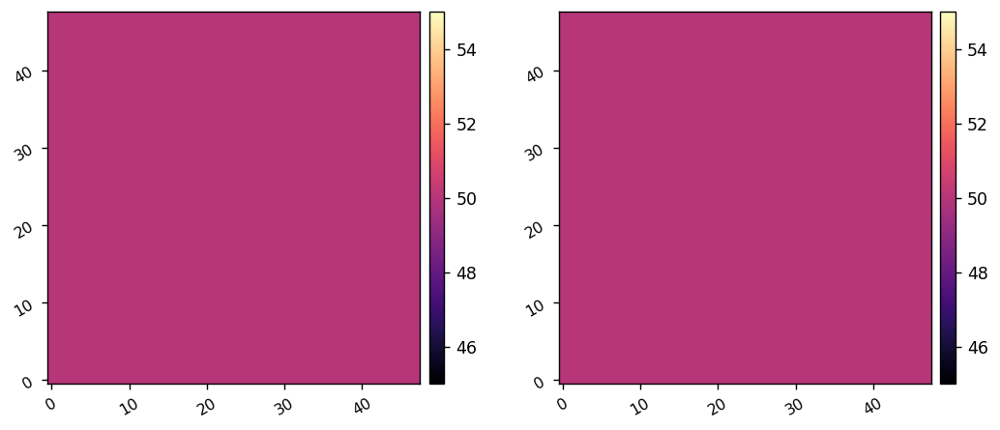

In [5]:
mp.full.dm1 = falco.config.Object()
mp.full.dm2 = falco.config.Object()

mp.full.dm1.flatmap = np.zeros((mp.dm1.Nact, mp.dm1.Nact))
mp.full.dm2.flatmap = np.zeros((mp.dm2.Nact, mp.dm2.Nact))

mp.full.dm1.flatmapNoSPM = np.zeros((mp.dm1.Nact, mp.dm1.Nact))
mp.full.dm2.flatmapNoSPM = np.zeros((mp.dm2.Nact, mp.dm2.Nact))

mp.dm1.biasMap = 50 + mp.full.dm1.flatmap/mp.dm1.VtoH
mp.dm2.biasMap = 50 + mp.full.dm2.flatmap/mp.dm2.VtoH
imshow2(mp.dm1.biasMap, mp.dm2.biasMap)

# Run idealized phase retrieval to make an accurate compact model

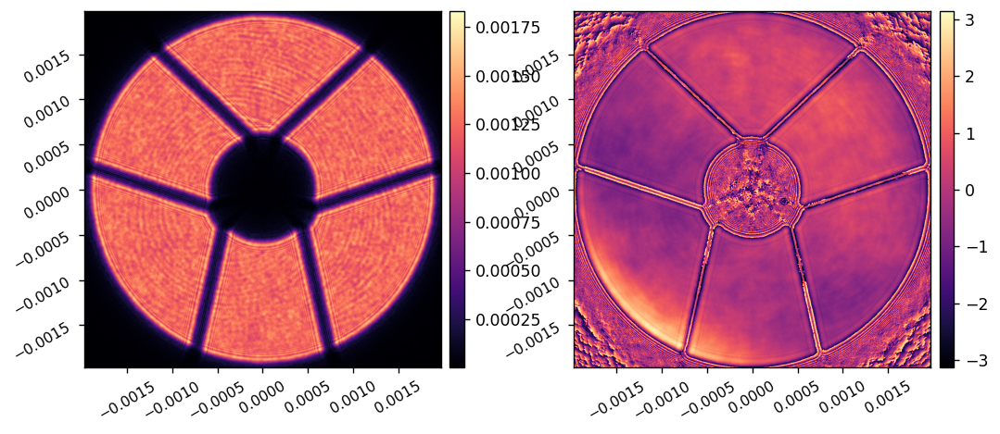

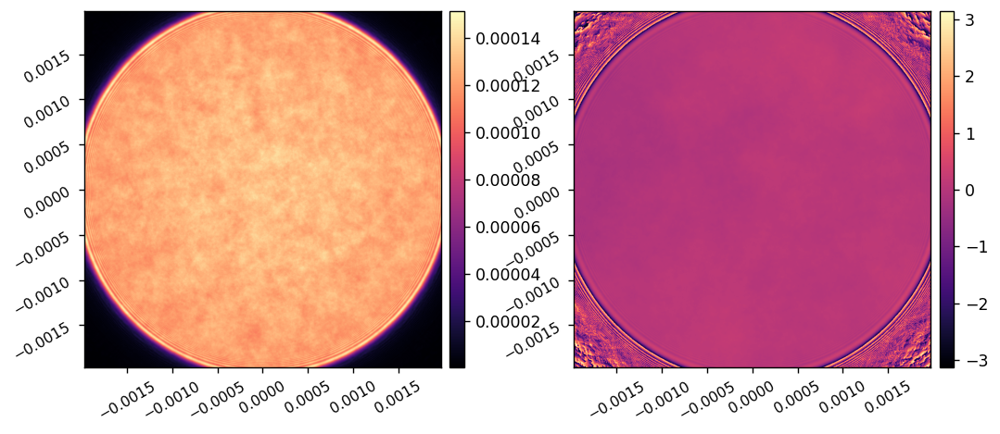

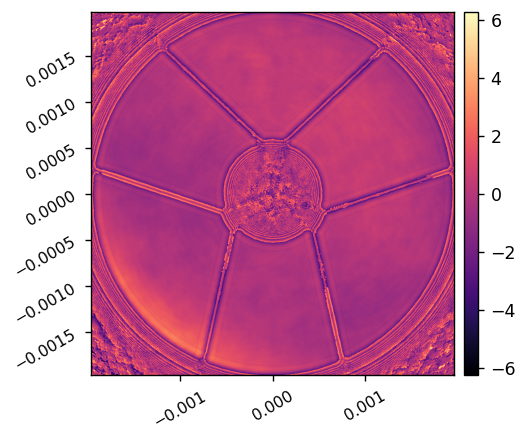

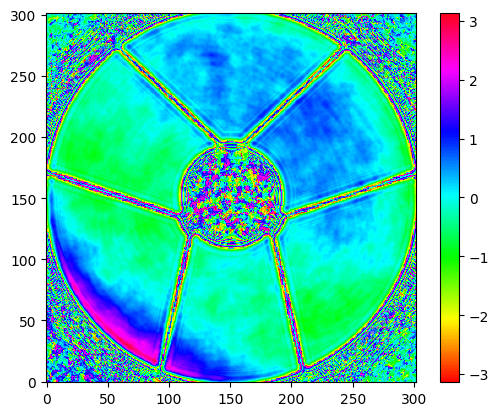

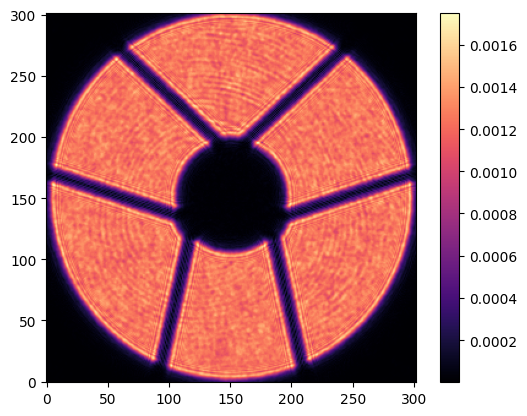

In [10]:
mp = pr.ipr(mp)

# Flesh out the workspace

spc_wfov_825_test
 Using 1 discrete wavelength(s) in each of 1 sub-bandpasses over a 1.0% total bandpass 

Sub-bandpasses are centered at wavelengths [nm]:	 [825.]


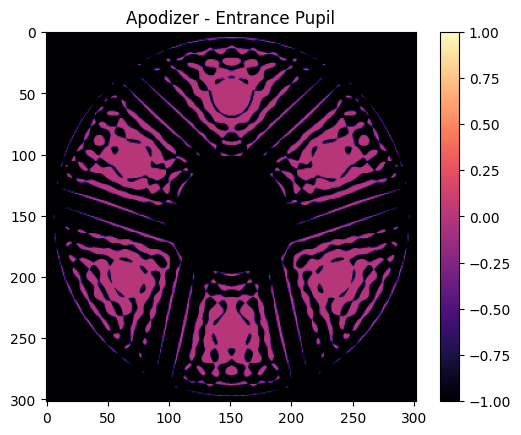

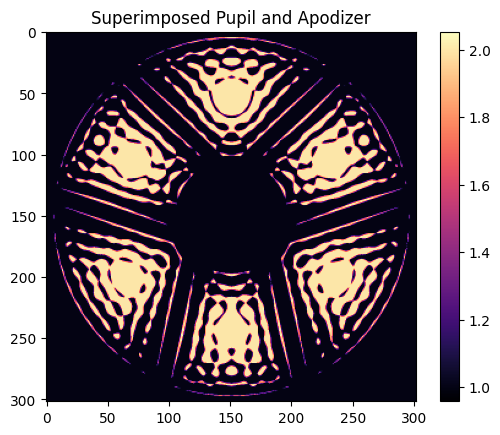

  Influence function padded from 84 to 84 points for A.S. propagation.
Computing datacube of DM influence functions... done.
  Influence function padded from 84 to 84 points for A.S. propagation.
Computing datacube of DM influence functions... done.


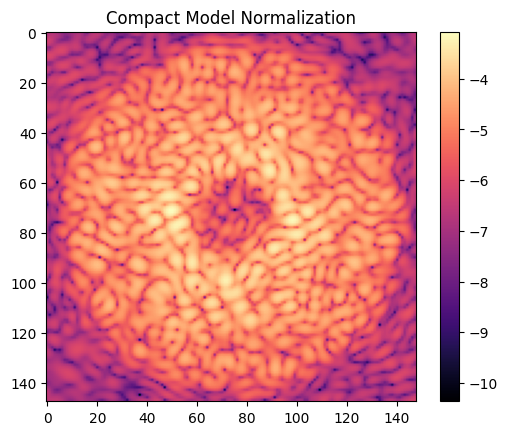

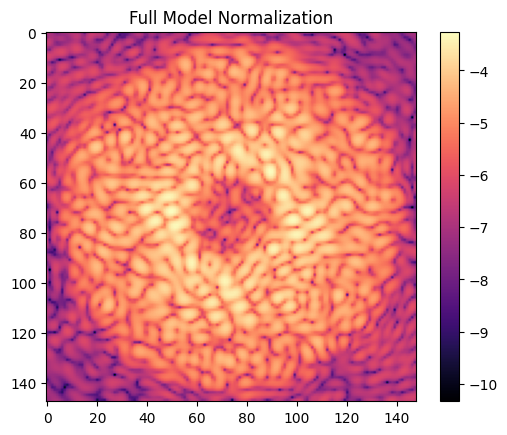


Beginning Trial 1 of Series 1.

DM 1-to-2 Fresnel number (using radius) = 649.6030303030303


In [11]:
# Record Keeping
mp.runLabel = ('spc_wfov_825_test')
print(mp.runLabel)
mp.TrialNum = 1
mp.SeriesNum = 1

out = falco.setup.flesh_out_workspace(mp)


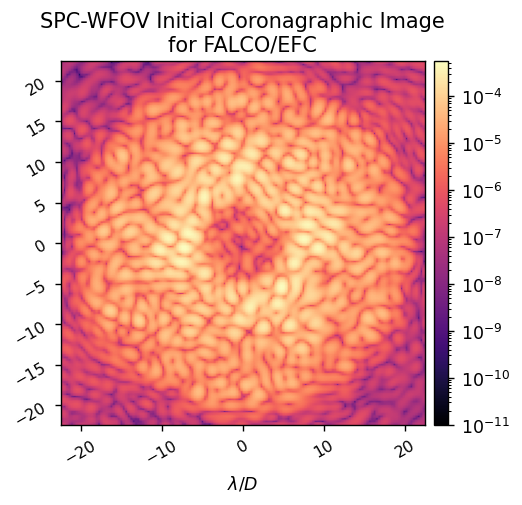

In [22]:
image = falco.get_summed_image(mp)
imshow1(image,  'SPC-WFOV Initial Coronagraphic Image\nfor FALCO/EFC', 
        lognorm=True, vmin=1e-11, pxscl=1/mp.Fend.res, xlabel='$\lambda/D$')

In [21]:
image.shape

(148, 148)

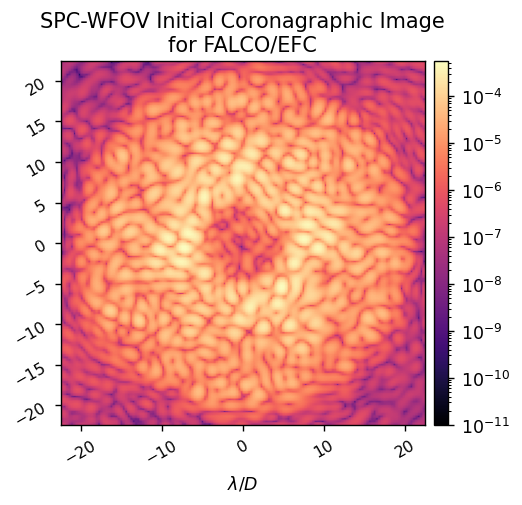

In [10]:
imshow1(image,  'SPC-WFOV Initial Coronagraphic Image\nfor FALCO/EFC', 
        lognorm=True, vmin=1e-11, pxscl=1/mp.Fend.res, xlabel='$\lambda/D$')

# Perform the Wavefront Sensing and Control

Iteration: 0 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


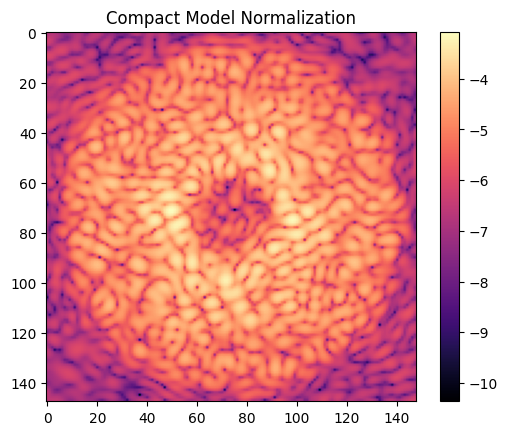

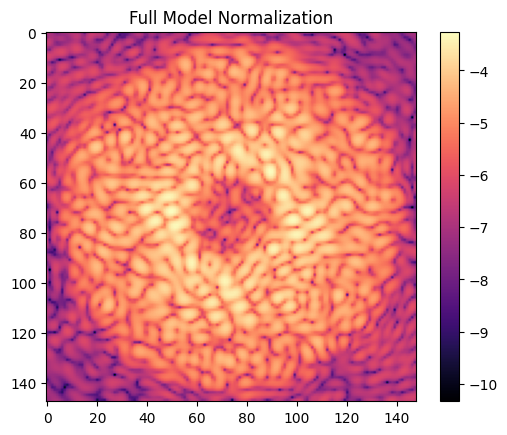

Core throughput within the half-max isophote(s) = 3.95% 	at separation = (13.0, 0.0) lambda0/D.
Computing control Jacobian matrices in parallel...done.
Elapsed: 32.20999360084534
Weeding out weak actuators from the control Jacobian...
  DM1: 1684/2304 (73.09%) actuators kept for Jacobian
  DM2: 1740/2304 (75.52%) actuators kept for Jacobian
[Getting updated summed image]	Elapsed: 111.23973417282104


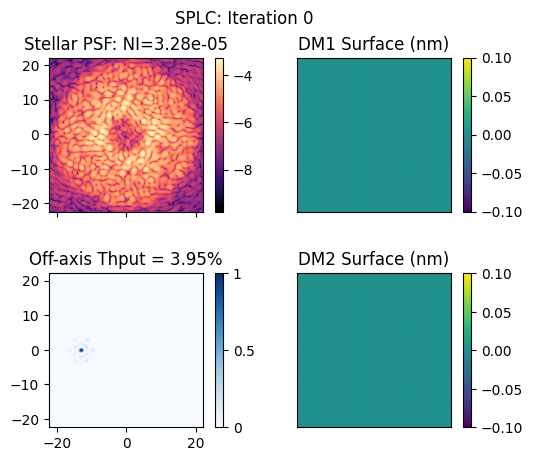

Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		1.37e-06	7.30e-07	6.14e-07	5.52e-07	5.02e-07	4.59e-07	4.30e-07	4.39e-07	
Model-based grid search expects log10reg, = -3.0,	 dmfac = 1.00,	 4.30e-07 normalized intensity.
 DM1 P-V in volts: 54.092
 DM2 P-V in volts: 68.252
RMS surface of DM1 = 5.8 nm
RMS surface of DM2 = 6.1 nm
Previous Measured NI:			 3.28e-05 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 1 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


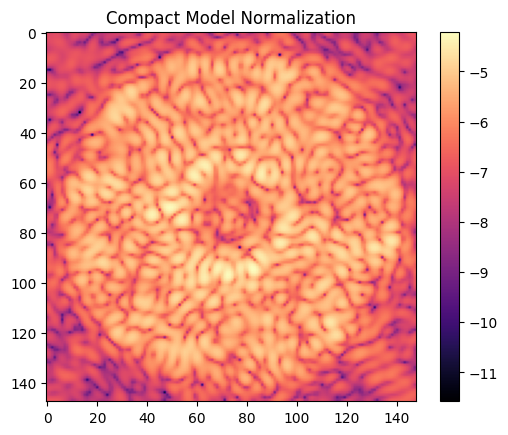

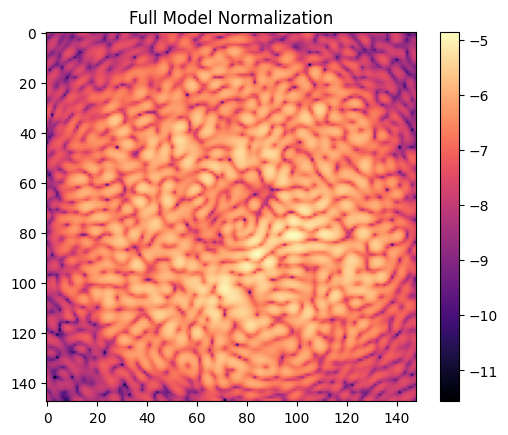

Core throughput within the half-max isophote(s) = 3.97% 	at separation = (13.0, 0.0) lambda0/D.
[Getting updated summed image]	Elapsed: 107.93162369728088


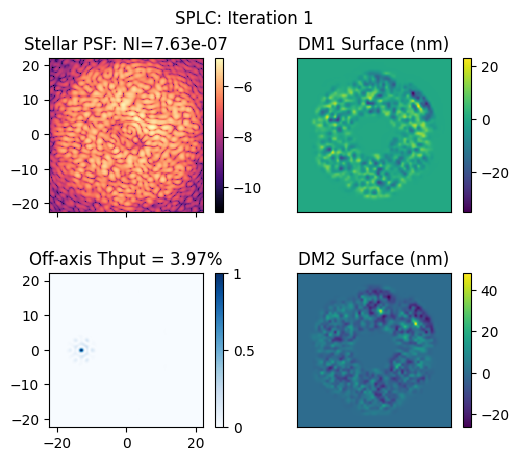

Complex projection of deltaE is 1.06    for subband 0/0
Complex correlation of deltaE is 1.00    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		4.16e-07	3.45e-07	2.96e-07	2.59e-07	2.29e-07	2.12e-07	2.13e-07	2.34e-07	
Model-based grid search expects log10reg, = -3.5,	 dmfac = 1.00,	 2.12e-07 normalized intensity.
 DM1 P-V in volts: 65.596
 DM2 P-V in volts: 61.914
RMS surface of DM1 = 7.3 nm
RMS surface of DM2 = 7.3 nm
Previous Measured NI:			 7.63e-07 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 2 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


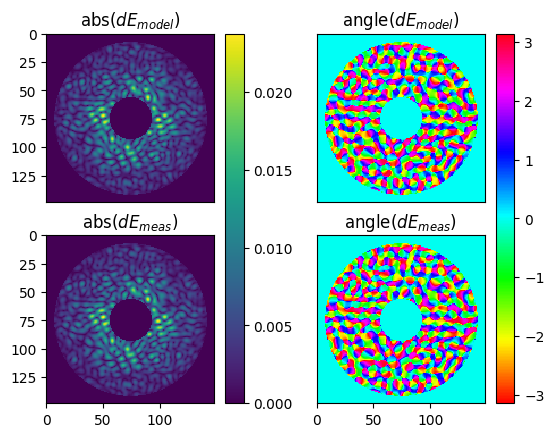

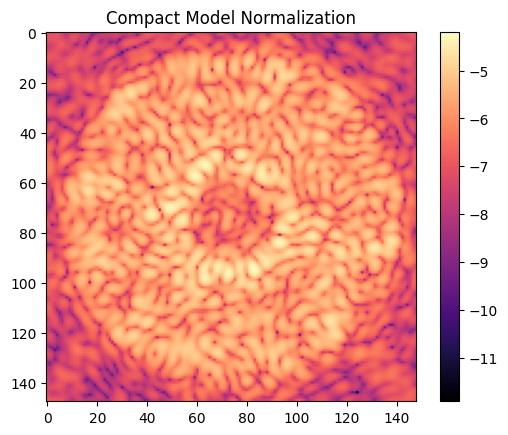

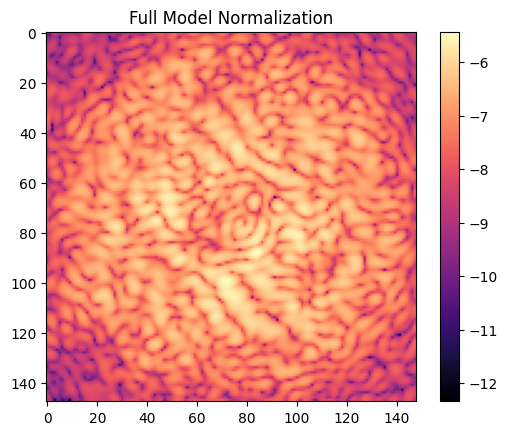

Core throughput within the half-max isophote(s) = 4.00% 	at separation = (13.0, 0.0) lambda0/D.
[Getting updated summed image]	Elapsed: 110.89485287666321


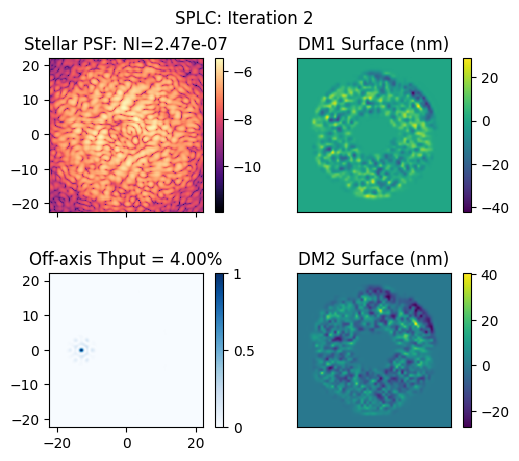

Complex projection of deltaE is 1.01    for subband 0/0
Complex correlation of deltaE is 1.02    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		2.37e-07	1.94e-07	1.63e-07	1.39e-07	1.21e-07	1.13e-07	1.11e-07	1.16e-07	
Model-based grid search expects log10reg, = -3.0,	 dmfac = 1.00,	 1.11e-07 normalized intensity.
 DM1 P-V in volts: 63.285
 DM2 P-V in volts: 58.822
RMS surface of DM1 = 7.9 nm
RMS surface of DM2 = 7.8 nm
Previous Measured NI:			 2.47e-07 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 3 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


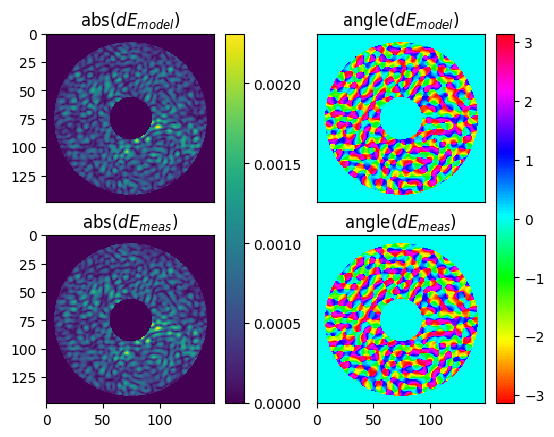

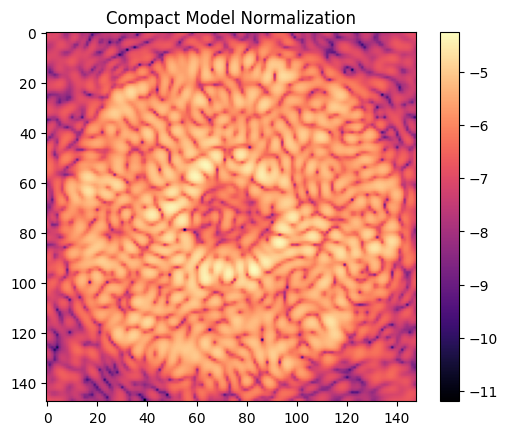

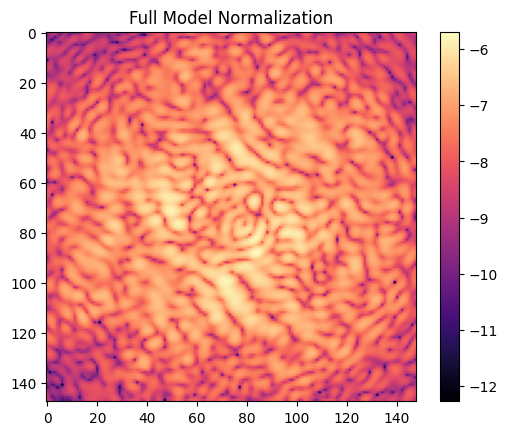

Core throughput within the half-max isophote(s) = 4.07% 	at separation = (13.0, 0.0) lambda0/D.
[Getting updated summed image]	Elapsed: 110.2216477394104


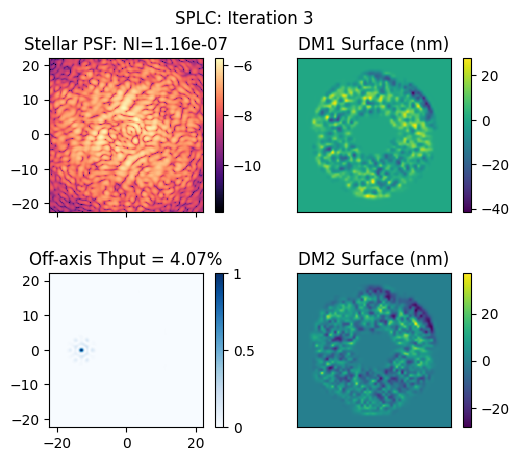

Complex projection of deltaE is 1.32    for subband 0/0
Complex correlation of deltaE is 0.98    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		1.68e-07	1.32e-07	1.06e-07	8.54e-08	7.05e-08	6.29e-08	6.07e-08	6.14e-08	
Model-based grid search expects log10reg, = -3.0,	 dmfac = 1.00,	 6.07e-08 normalized intensity.
 DM1 P-V in volts: 61.516
 DM2 P-V in volts: 57.830
RMS surface of DM1 = 8.5 nm
RMS surface of DM2 = 8.3 nm
Previous Measured NI:			 1.16e-07 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 4 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


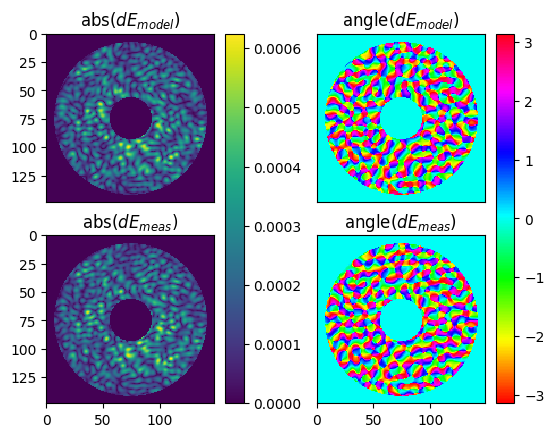

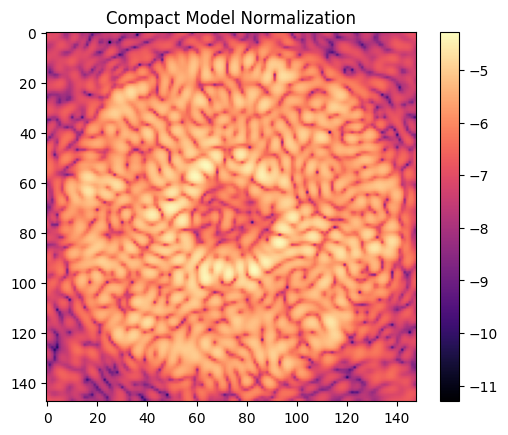

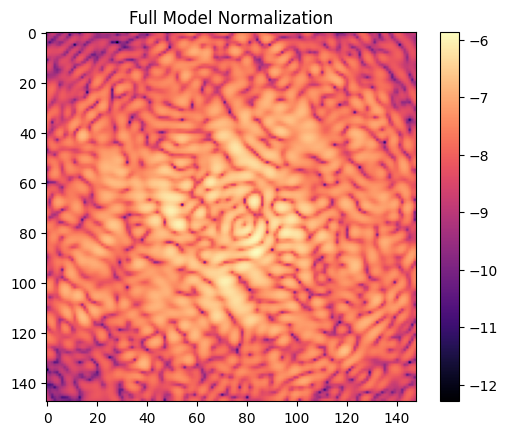

Core throughput within the half-max isophote(s) = 4.04% 	at separation = (13.0, 0.0) lambda0/D.


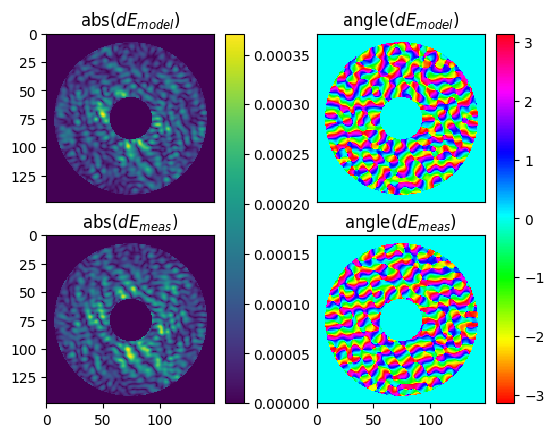

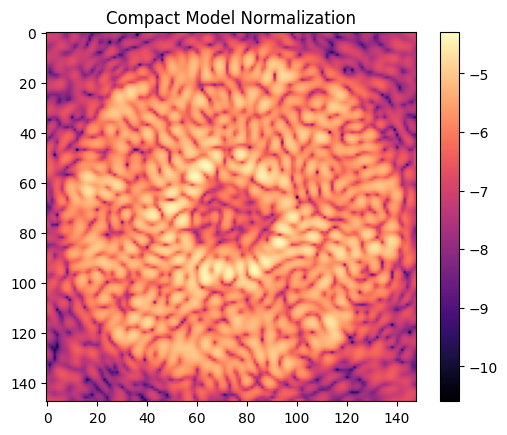

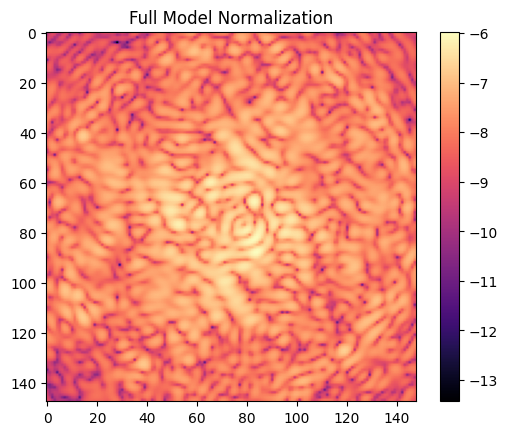

Core throughput within the half-max isophote(s) = 4.04% 	at separation = (13.0, 0.0) lambda0/D.
[Getting updated summed image]	Elapsed: 109.48795938491821


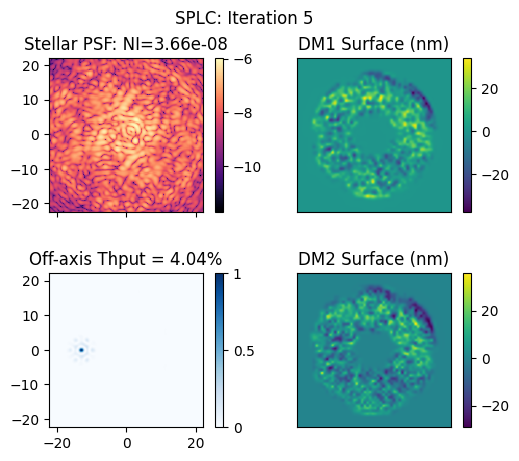

Complex projection of deltaE is 0.87    for subband 0/0
Complex correlation of deltaE is 1.07    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		1.15e-07	8.19e-08	6.00e-08	4.35e-08	3.19e-08	2.61e-08	2.39e-08	2.35e-08	
Model-based grid search expects log10reg, = -2.5,	 dmfac = 1.00,	 2.35e-08 normalized intensity.
 DM1 P-V in volts: 65.410
 DM2 P-V in volts: 57.889
RMS surface of DM1 = 9.1 nm
RMS surface of DM2 = 8.7 nm
Previous Measured NI:			 3.66e-08 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 6 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


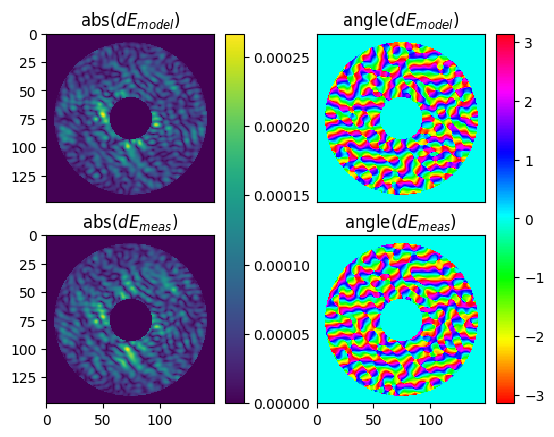

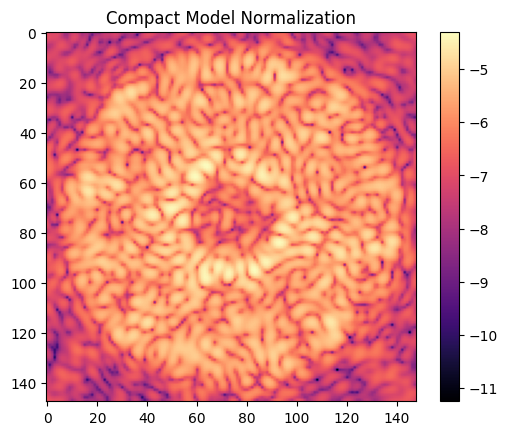

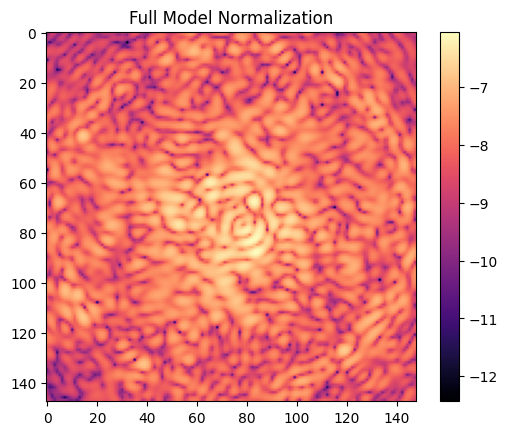

Core throughput within the half-max isophote(s) = 4.01% 	at separation = (13.0, 0.0) lambda0/D.
[Getting updated summed image]	Elapsed: 102.68042302131653


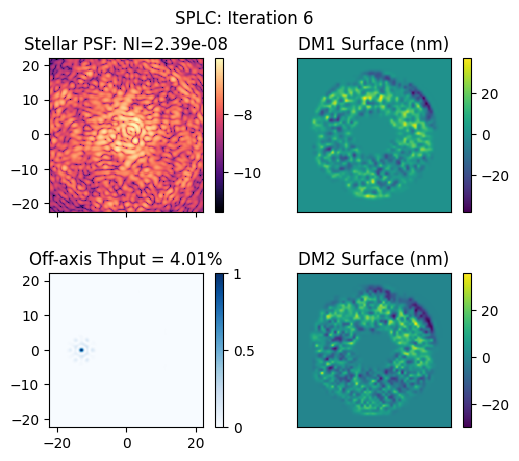

Complex projection of deltaE is 1.08    for subband 0/0
Complex correlation of deltaE is 1.28    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		1.05e-07	7.24e-08	5.11e-08	3.54e-08	2.45e-08	1.91e-08	1.72e-08	1.68e-08	
Model-based grid search expects log10reg, = -2.5,	 dmfac = 1.00,	 1.68e-08 normalized intensity.
 DM1 P-V in volts: 67.864
 DM2 P-V in volts: 58.318
RMS surface of DM1 = 9.3 nm
RMS surface of DM2 = 8.9 nm
Previous Measured NI:			 2.39e-08 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 7 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


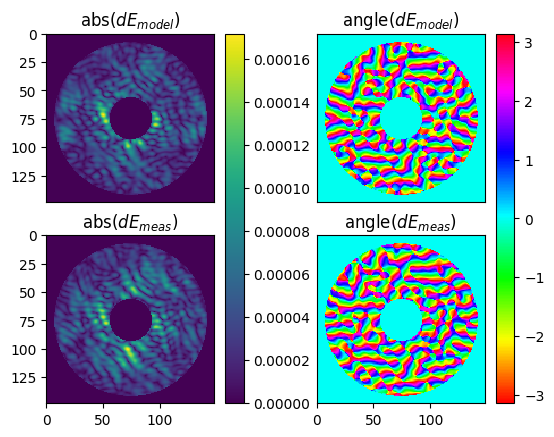

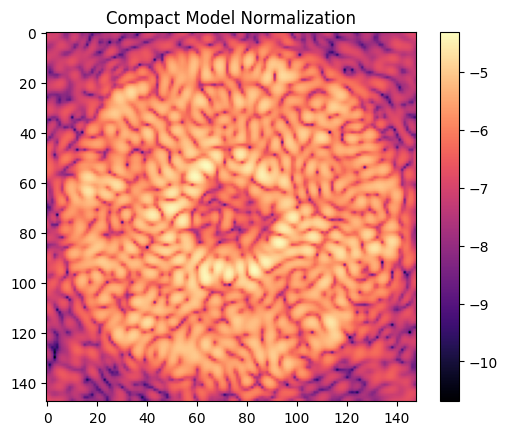

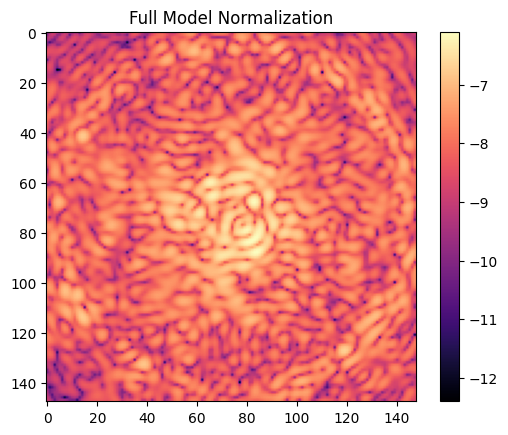

Core throughput within the half-max isophote(s) = 3.94% 	at separation = (13.0, 0.0) lambda0/D.
[Getting updated summed image]	Elapsed: 103.64998245239258


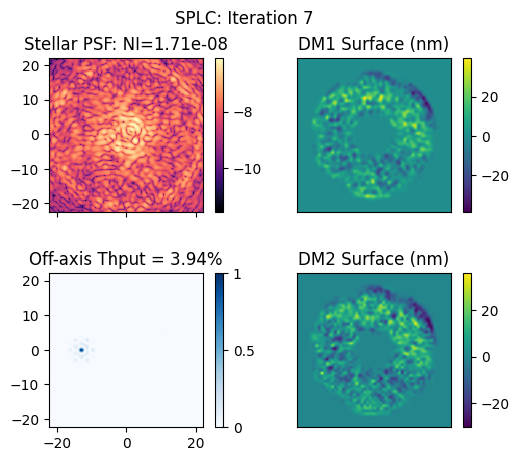

Complex projection of deltaE is 1.37    for subband 0/0
Complex correlation of deltaE is 1.48    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		9.94e-08	6.65e-08	4.55e-08	3.02e-08	1.97e-08	1.47e-08	1.31e-08	1.28e-08	
Model-based grid search expects log10reg, = -2.5,	 dmfac = 1.00,	 1.28e-08 normalized intensity.
 DM1 P-V in volts: 69.883
 DM2 P-V in volts: 58.653
RMS surface of DM1 = 9.5 nm
RMS surface of DM2 = 9.1 nm
Previous Measured NI:			 1.71e-08 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 8 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


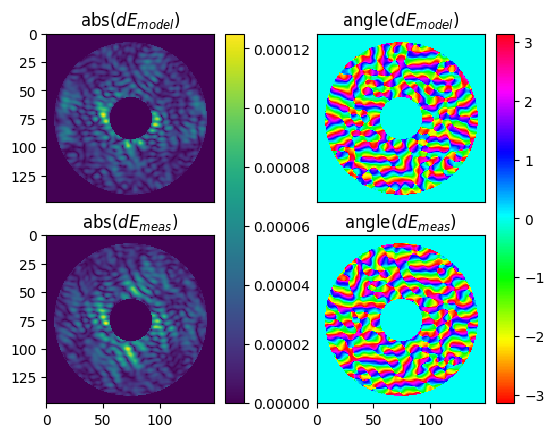

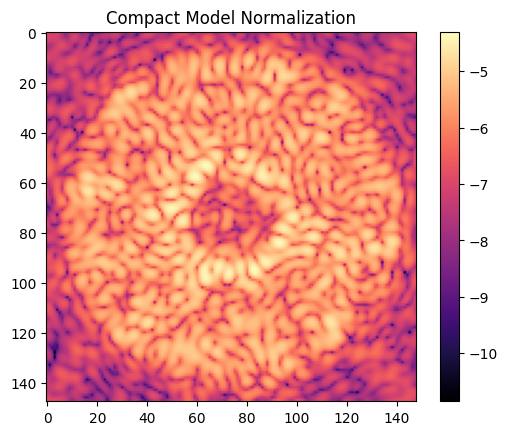

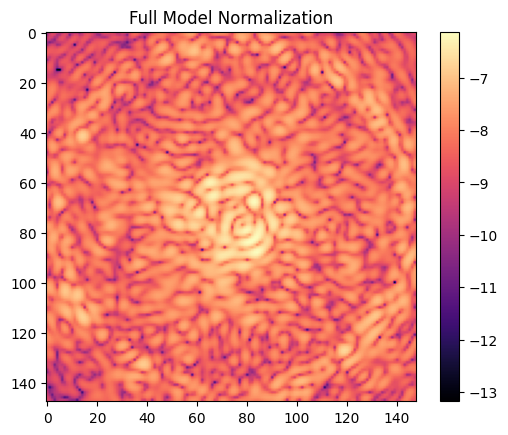

Core throughput within the half-max isophote(s) = 3.94% 	at separation = (13.0, 0.0) lambda0/D.
[Getting updated summed image]	Elapsed: 103.70014572143555


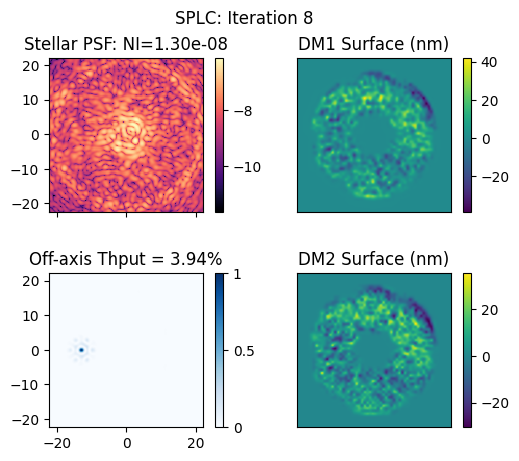

Complex projection of deltaE is 2.09    for subband 0/0
Complex correlation of deltaE is 1.77    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		9.54e-08	6.24e-08	4.15e-08	2.65e-08	1.65e-08	1.18e-08	1.04e-08	1.02e-08	
Model-based grid search expects log10reg, = -2.5,	 dmfac = 1.00,	 1.02e-08 normalized intensity.
 DM1 P-V in volts: 71.586
 DM2 P-V in volts: 59.009
RMS surface of DM1 = 9.6 nm
RMS surface of DM2 = 9.3 nm
Previous Measured NI:			 1.30e-08 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 9 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


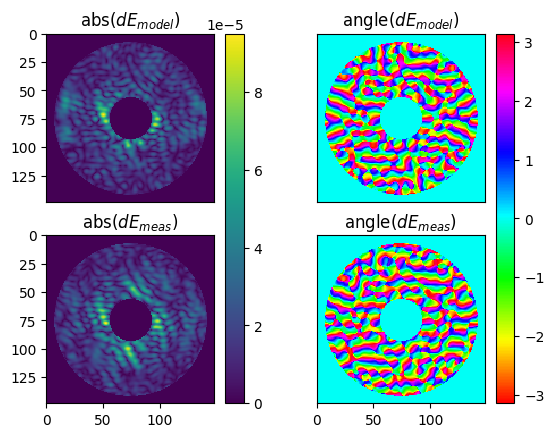

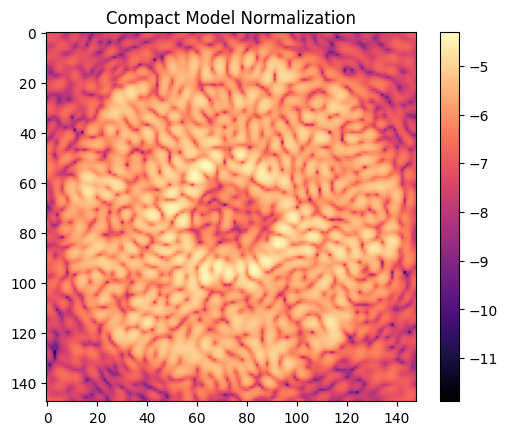

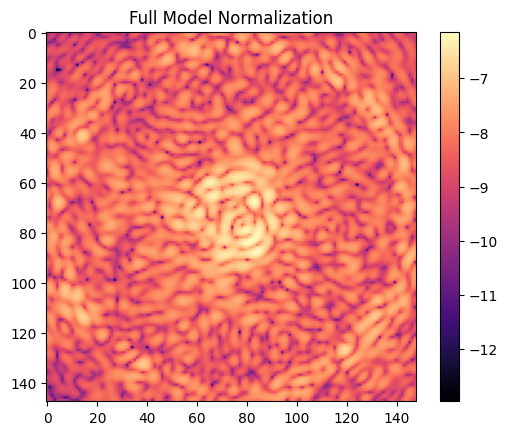

Core throughput within the half-max isophote(s) = 3.91% 	at separation = (13.0, 0.0) lambda0/D.
[Getting updated summed image]	Elapsed: 102.9520194530487


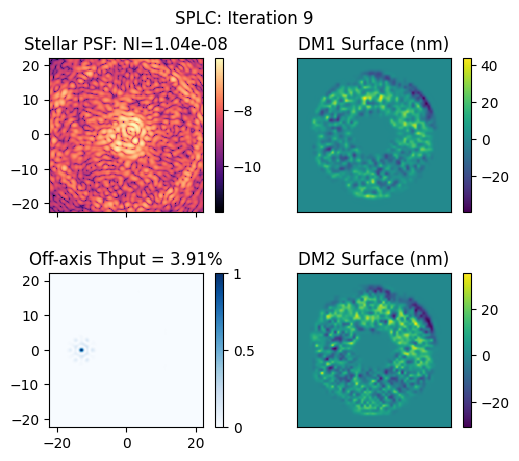

Complex projection of deltaE is 10.90    for subband 0/0
Complex correlation of deltaE is 3.86    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		9.25e-08	5.92e-08	3.84e-08	2.37e-08	1.40e-08	9.67e-09	8.47e-09	8.36e-09	
Model-based grid search expects log10reg, = -2.5,	 dmfac = 1.00,	 8.36e-09 normalized intensity.
 DM1 P-V in volts: 73.060
 DM2 P-V in volts: 59.654
RMS surface of DM1 = 9.8 nm
RMS surface of DM2 = 9.4 nm
Previous Measured NI:			 1.04e-08 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Core throughput within the half-max isophote(s) = 3.94% 	at separation = (13.0, 0.0) lambda0/D.

Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl...done.

Entire workspace NO

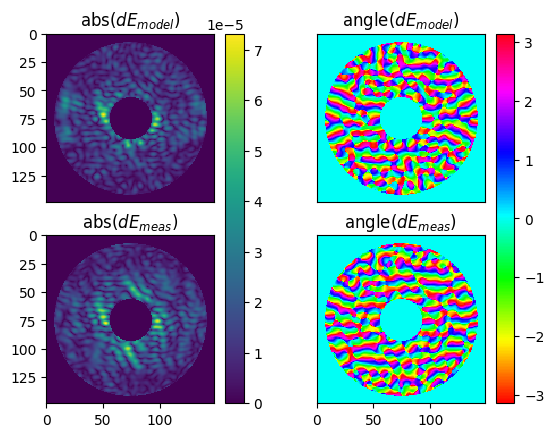

In [12]:
falco.wfsc.loop(mp, out)
misc.save_pickle('results/' + mp.runLabel + f'_mp_without_relin{date}.pkl', mp)
misc.save_pickle('results/' + mp.runLabel + f'_out_without_relin{date}.pkl', out)

Iteration: 0 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


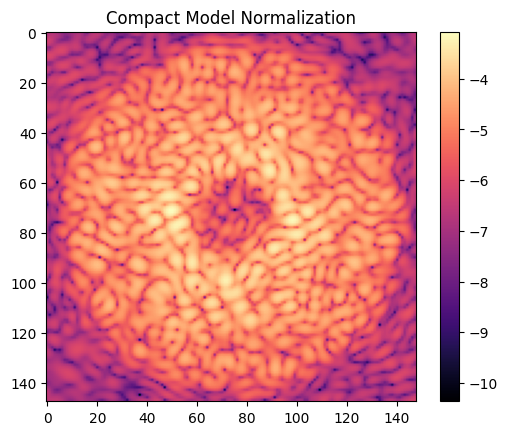

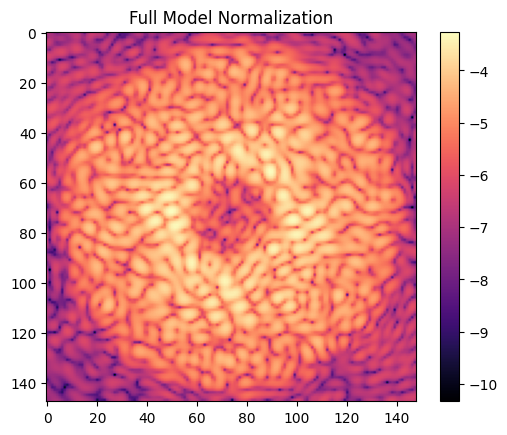

Core throughput within the half-max isophote(s) = 3.95% 	at separation = (13.0, 0.0) lambda0/D.
Computing control Jacobian matrices in parallel...done.
Elapsed: 32.39396667480469
Weeding out weak actuators from the control Jacobian...
  DM1: 1684/2304 (73.09%) actuators kept for Jacobian
  DM2: 1740/2304 (75.52%) actuators kept for Jacobian
[Getting updated summed image]	Elapsed: 105.22060108184814


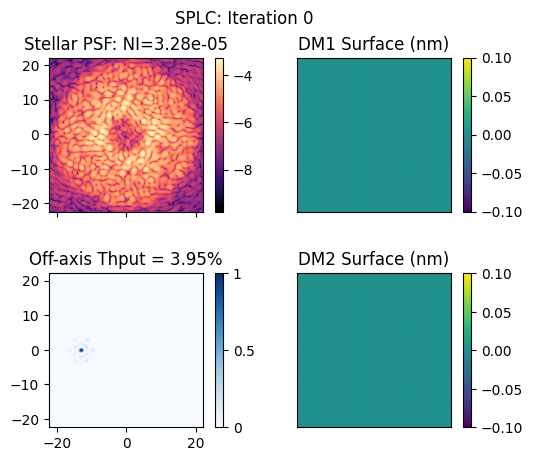

Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		1.37e-06	7.30e-07	6.14e-07	5.52e-07	5.02e-07	4.59e-07	4.30e-07	4.39e-07	
Model-based grid search expects log10reg, = -3.0,	 dmfac = 1.00,	 4.30e-07 normalized intensity.
 DM1 P-V in volts: 54.092
 DM2 P-V in volts: 68.252
RMS surface of DM1 = 5.8 nm
RMS surface of DM2 = 6.1 nm
Previous Measured NI:			 3.28e-05 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 1 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


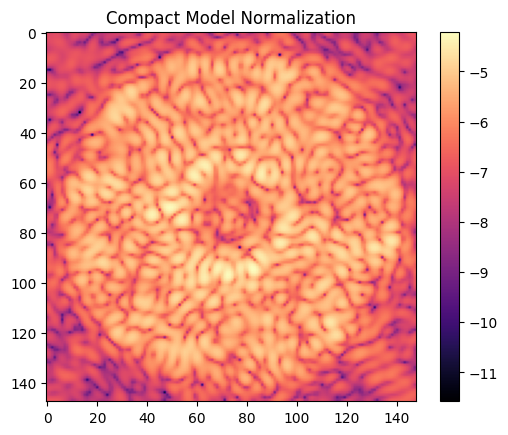

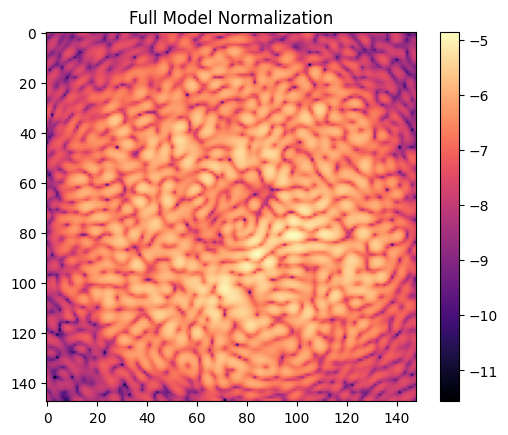

Core throughput within the half-max isophote(s) = 3.97% 	at separation = (13.0, 0.0) lambda0/D.
Computing control Jacobian matrices in parallel...done.
Elapsed: 23.723331212997437
[Getting updated summed image]	Elapsed: 105.17914509773254


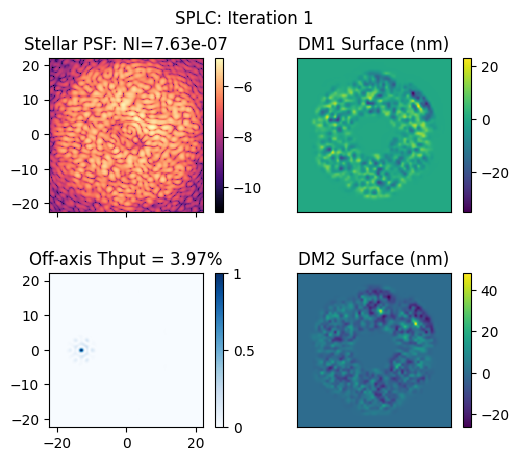

Complex projection of deltaE is 1.06    for subband 0/0
Complex correlation of deltaE is 1.00    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		4.28e-08	2.98e-08	2.15e-08	1.59e-08	1.33e-08	1.57e-08	2.68e-08	5.49e-08	
Model-based grid search expects log10reg, = -4.0,	 dmfac = 1.00,	 1.33e-08 normalized intensity.
 DM1 P-V in volts: 59.020
 DM2 P-V in volts: 60.939
RMS surface of DM1 = 8.4 nm
RMS surface of DM2 = 7.9 nm
Previous Measured NI:			 7.63e-07 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 2 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


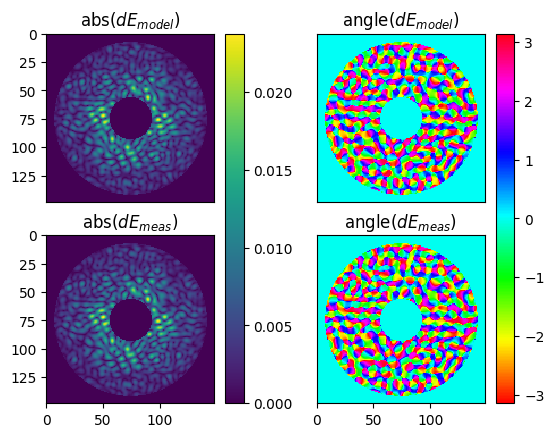

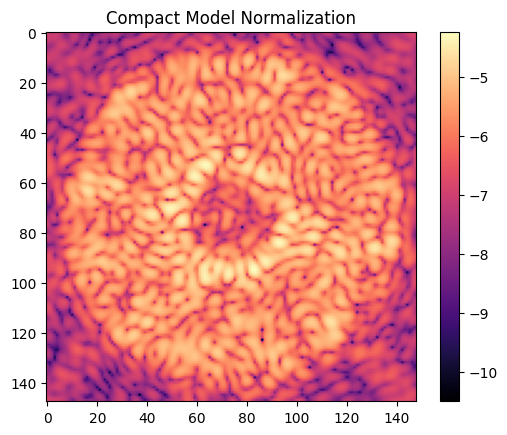

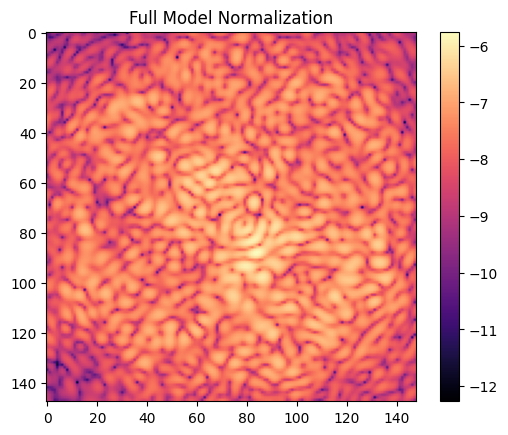

Core throughput within the half-max isophote(s) = 4.07% 	at separation = (13.0, 0.0) lambda0/D.
Computing control Jacobian matrices in parallel...done.
Elapsed: 23.86924958229065
[Getting updated summed image]	Elapsed: 105.51766896247864


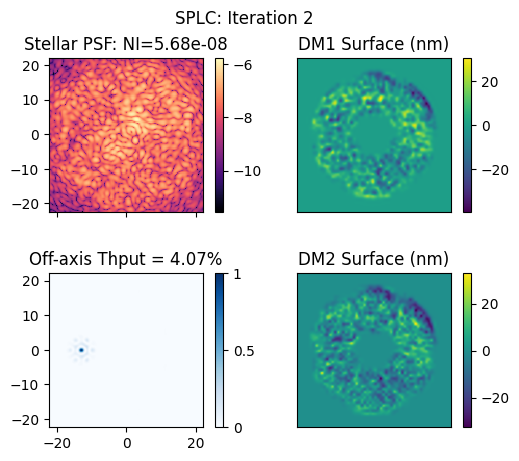

Complex projection of deltaE is 0.93    for subband 0/0
Complex correlation of deltaE is 1.01    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		7.25e-09	2.93e-09	1.57e-09	1.38e-09	2.05e-09	3.33e-09	5.14e-09	7.84e-09	
Model-based grid search expects log10reg, = -4.5,	 dmfac = 1.00,	 1.38e-09 normalized intensity.
 DM1 P-V in volts: 73.974
 DM2 P-V in volts: 73.793
RMS surface of DM1 = 9.7 nm
RMS surface of DM2 = 9.5 nm
Previous Measured NI:			 5.68e-08 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 3 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


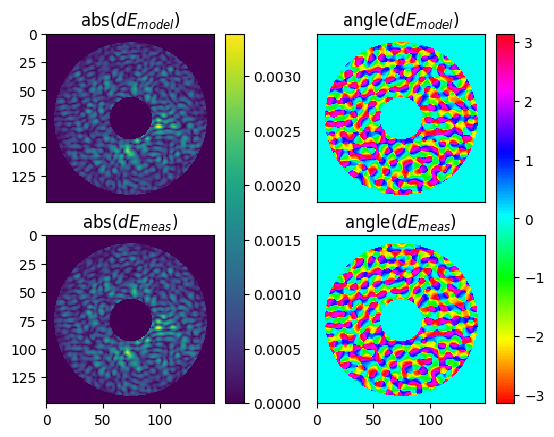

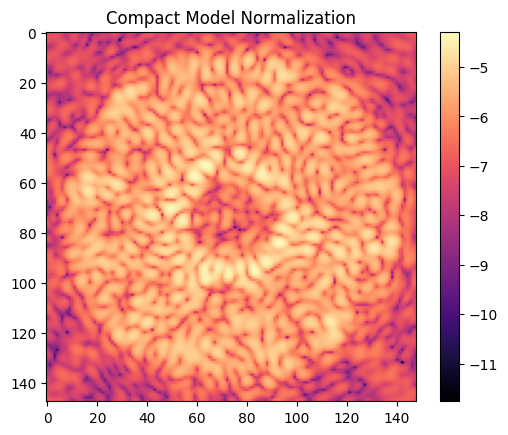

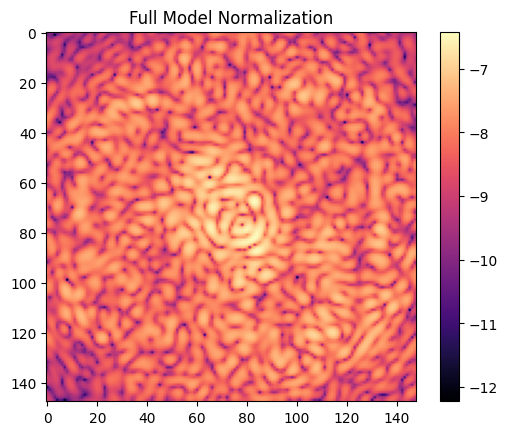

Core throughput within the half-max isophote(s) = 4.03% 	at separation = (13.0, 0.0) lambda0/D.
Computing control Jacobian matrices in parallel...done.
Elapsed: 23.356775760650635
[Getting updated summed image]	Elapsed: 105.81157159805298


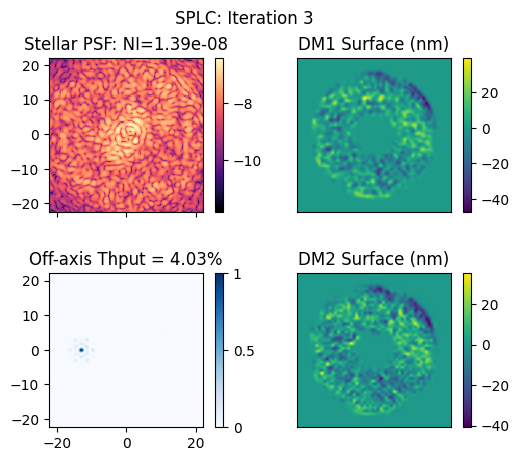

Complex projection of deltaE is 0.56    for subband 0/0
Complex correlation of deltaE is 1.03    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		2.50e-09	7.11e-10	4.59e-10	5.93e-10	8.26e-10	1.09e-09	1.46e-09	2.15e-09	
Model-based grid search expects log10reg, = -5.0,	 dmfac = 1.00,	 4.59e-10 normalized intensity.
 DM1 P-V in volts: 82.265
 DM2 P-V in volts: 81.239
RMS surface of DM1 = 10.6 nm
RMS surface of DM2 = 10.6 nm
Previous Measured NI:			 1.39e-08 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 4 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


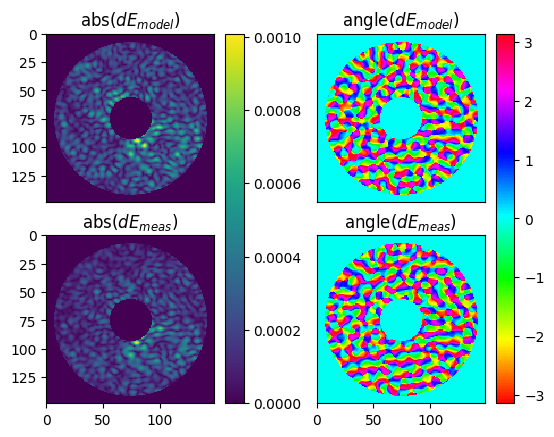

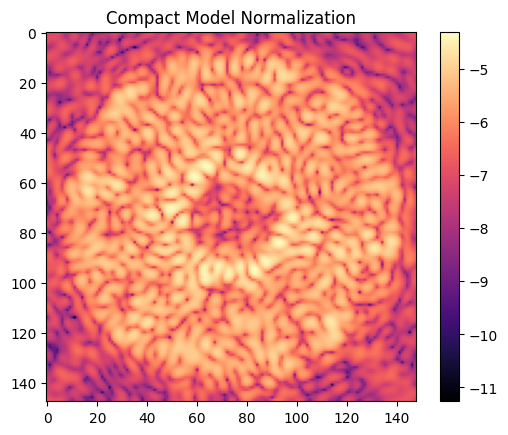

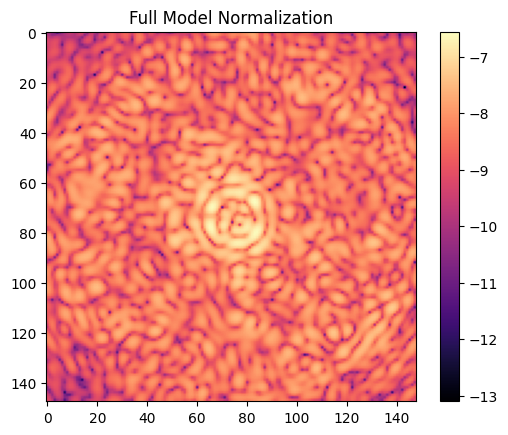

Core throughput within the half-max isophote(s) = 4.00% 	at separation = (13.0, 0.0) lambda0/D.
Computing control Jacobian matrices in parallel...done.
Elapsed: 23.53867816925049
[Getting updated summed image]	Elapsed: 105.06125831604004


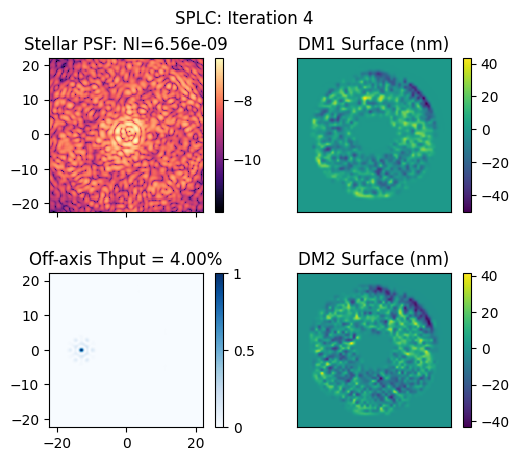

Complex projection of deltaE is 0.95    for subband 0/0
Complex correlation of deltaE is 1.19    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		8.72e-10	3.11e-10	2.53e-10	3.20e-10	3.85e-10	4.69e-10	6.45e-10	1.03e-09	
Model-based grid search expects log10reg, = -5.0,	 dmfac = 1.00,	 2.53e-10 normalized intensity.
 DM1 P-V in volts: 86.148
 DM2 P-V in volts: 84.156
RMS surface of DM1 = 11.1 nm
RMS surface of DM2 = 11.2 nm
Previous Measured NI:			 6.56e-09 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 5 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


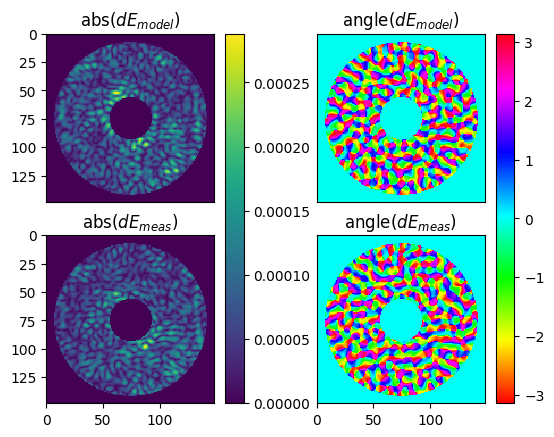

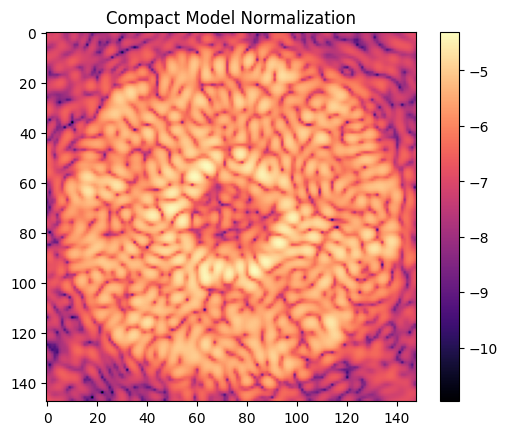

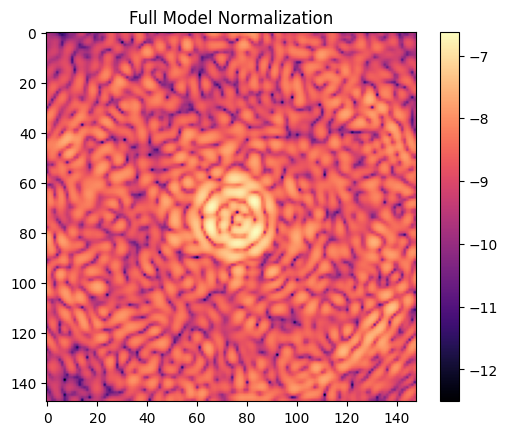

Core throughput within the half-max isophote(s) = 3.98% 	at separation = (13.0, 0.0) lambda0/D.
Computing control Jacobian matrices in parallel...done.
Elapsed: 23.651306867599487
[Getting updated summed image]	Elapsed: 105.14237189292908


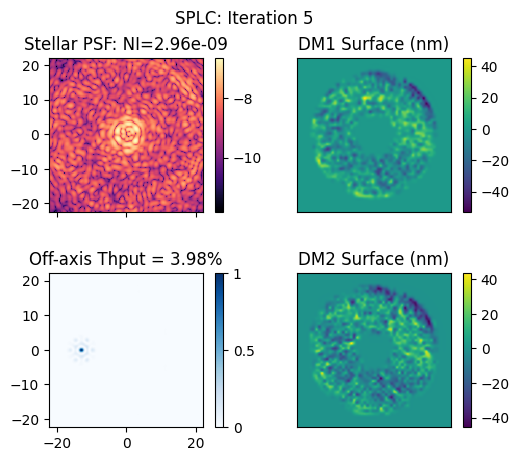

Complex projection of deltaE is 0.55    for subband 0/0
Complex correlation of deltaE is 1.01    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		4.55e-10	1.98e-10	1.89e-10	2.28e-10	2.59e-10	3.02e-10	4.04e-10	6.26e-10	
Model-based grid search expects log10reg, = -5.0,	 dmfac = 1.00,	 1.89e-10 normalized intensity.
 DM1 P-V in volts: 88.845
 DM2 P-V in volts: 86.229
RMS surface of DM1 = 11.4 nm
RMS surface of DM2 = 11.6 nm
Previous Measured NI:			 2.96e-09 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 6 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


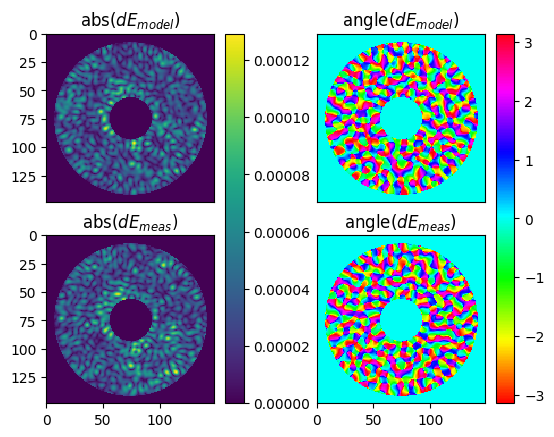

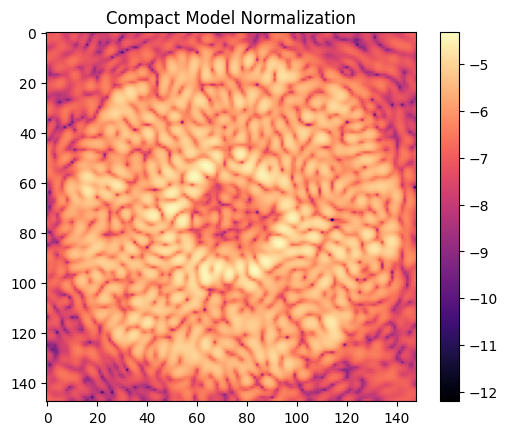

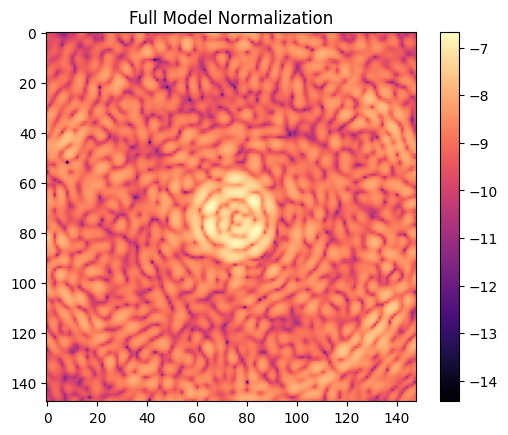

Core throughput within the half-max isophote(s) = 4.01% 	at separation = (13.0, 0.0) lambda0/D.
Computing control Jacobian matrices in parallel...done.
Elapsed: 23.560977458953857
[Getting updated summed image]	Elapsed: 104.31986427307129


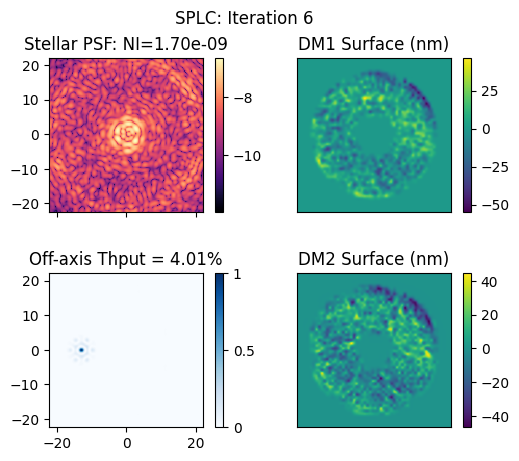

Complex projection of deltaE is 0.39    for subband 0/0
Complex correlation of deltaE is 0.71    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		2.98e-10	1.53e-10	1.60e-10	1.81e-10	1.99e-10	2.24e-10	2.87e-10	4.24e-10	
Model-based grid search expects log10reg, = -5.5,	 dmfac = 1.00,	 1.53e-10 normalized intensity.
 DM1 P-V in volts: 86.973
 DM2 P-V in volts: 90.243
RMS surface of DM1 = 11.8 nm
RMS surface of DM2 = 12.3 nm
Previous Measured NI:			 1.70e-09 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 7 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


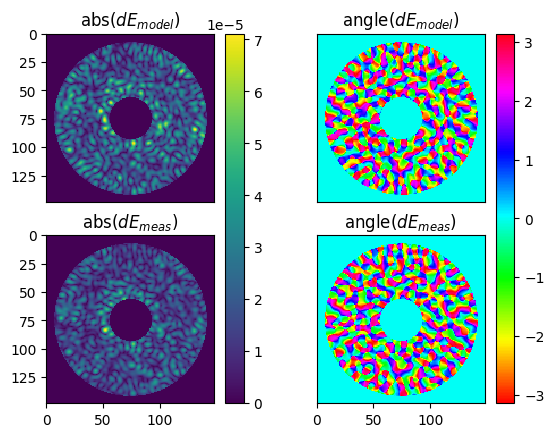

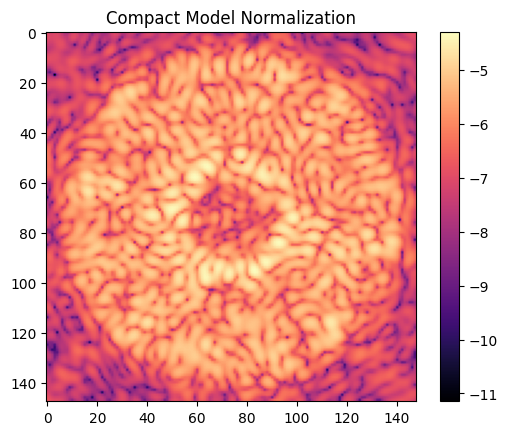

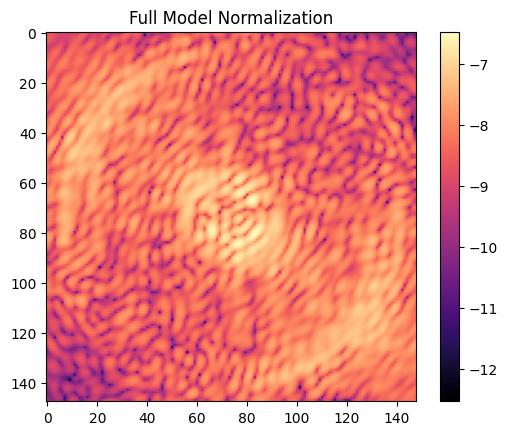

Core throughput within the half-max isophote(s) = 4.00% 	at separation = (13.0, 0.0) lambda0/D.
Computing control Jacobian matrices in parallel...done.
Elapsed: 23.588664770126343
[Getting updated summed image]	Elapsed: 104.50509786605835


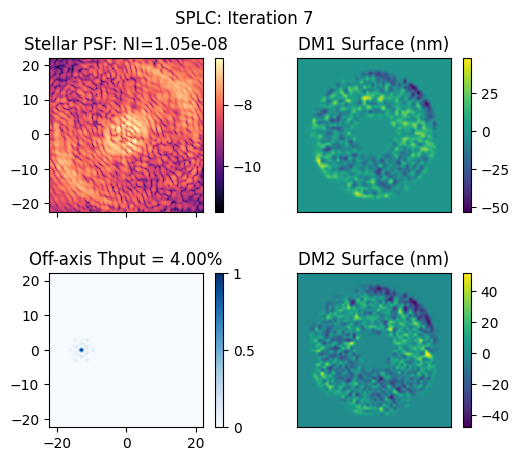

Complex projection of deltaE is 1.09    for subband 0/0
Complex correlation of deltaE is 1.01    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		3.52e-09	1.31e-09	1.01e-09	7.56e-10	6.06e-10	5.51e-10	6.76e-10	1.11e-09	
Model-based grid search expects log10reg, = -3.5,	 dmfac = 1.00,	 5.51e-10 normalized intensity.
 DM1 P-V in volts: 89.117
 DM2 P-V in volts: 90.783
RMS surface of DM1 = 11.9 nm
RMS surface of DM2 = 12.4 nm
Previous Measured NI:			 1.05e-08 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 8 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


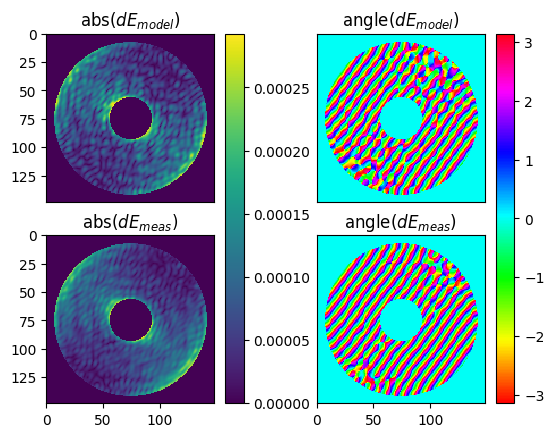

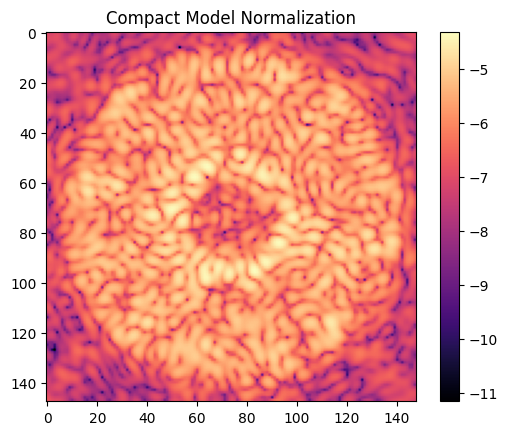

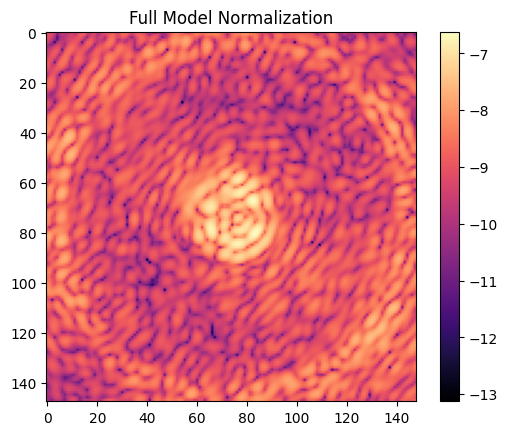

Core throughput within the half-max isophote(s) = 3.99% 	at separation = (13.0, 0.0) lambda0/D.
Computing control Jacobian matrices in parallel...done.
Elapsed: 23.483511209487915
[Getting updated summed image]	Elapsed: 104.53611922264099


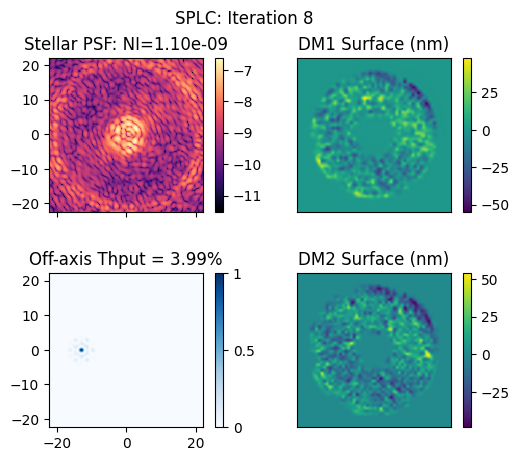

Complex projection of deltaE is 0.97    for subband 0/0
Complex correlation of deltaE is 0.96    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		2.91e-09	9.24e-10	6.44e-10	4.32e-10	3.06e-10	2.59e-10	2.77e-10	3.39e-10	
Model-based grid search expects log10reg, = -3.5,	 dmfac = 1.00,	 2.59e-10 normalized intensity.
 DM1 P-V in volts: 90.015
 DM2 P-V in volts: 91.079
RMS surface of DM1 = 11.9 nm
RMS surface of DM2 = 12.4 nm
Previous Measured NI:			 1.10e-09 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Iteration: 9 / 9
Zernike modes (Noll indexing) used in this Jacobian:	[1]
DMs to be used in this iteration = [ 1 2 ]


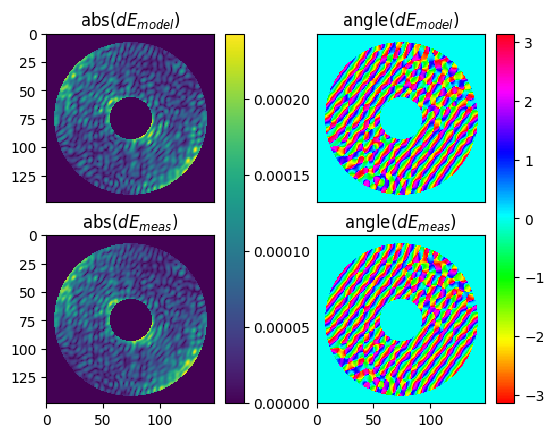

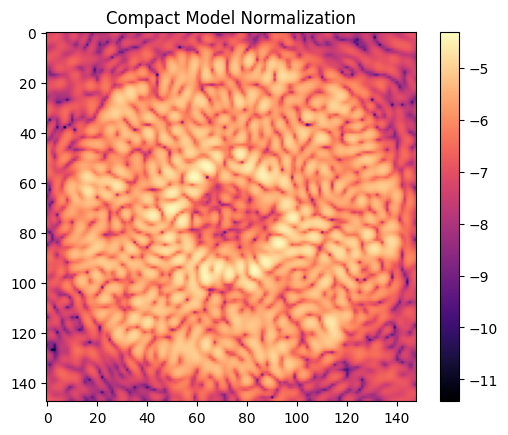

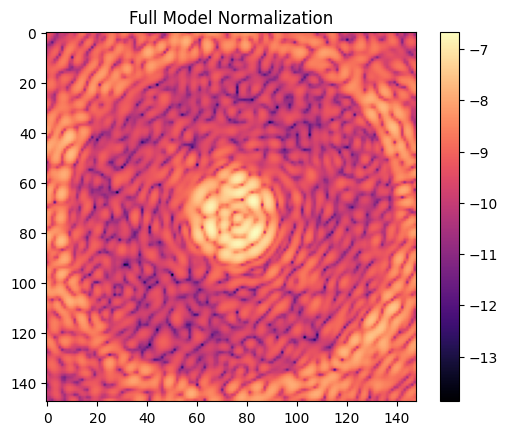

Core throughput within the half-max isophote(s) = 3.99% 	at separation = (13.0, 0.0) lambda0/D.
Computing control Jacobian matrices in parallel...done.
Elapsed: 23.787065029144287
[Getting updated summed image]	Elapsed: 105.92894148826599


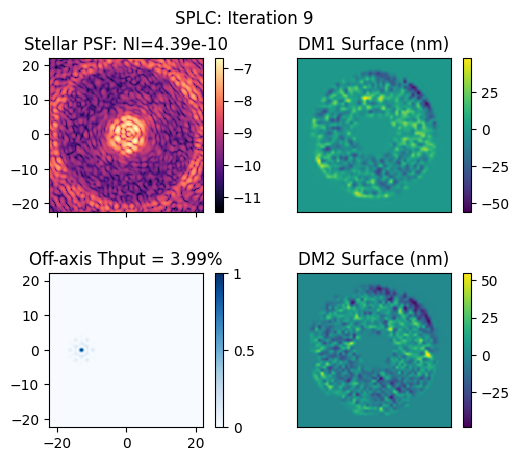

Complex projection of deltaE is 0.53    for subband 0/0
Complex correlation of deltaE is 0.83    for subband 0/0
Using the Jacobian to make other matrices...done.
Control beginning ...
Scaling factor:		1.00		1.00		1.00		1.00		1.00		1.00		1.00		1.00		
log10reg:    		-6.0		-5.5		-5.0		-4.5		-4.0		-3.5		-3.0		-2.5		
Inorm:       		2.60e-09	7.63e-10	5.01e-10	3.28e-10	2.31e-10	2.00e-10	2.05e-10	2.22e-10	
Model-based grid search expects log10reg, = -3.5,	 dmfac = 1.00,	 2.00e-10 normalized intensity.
 DM1 P-V in volts: 90.423
 DM2 P-V in volts: 91.234
RMS surface of DM1 = 11.9 nm
RMS surface of DM2 = 12.4 nm
Previous Measured NI:			 4.39e-10 
Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl  ...done.

Core throughput within the half-max isophote(s) = 3.99% 	at separation = (13.0, 0.0) lambda0/D.

Saving data snippet to:
	/home/u21/kianmilani/Documents/falco-python/data/brief/spc_wfov_825_test_snippet.pkl...done.

Entire workspace N

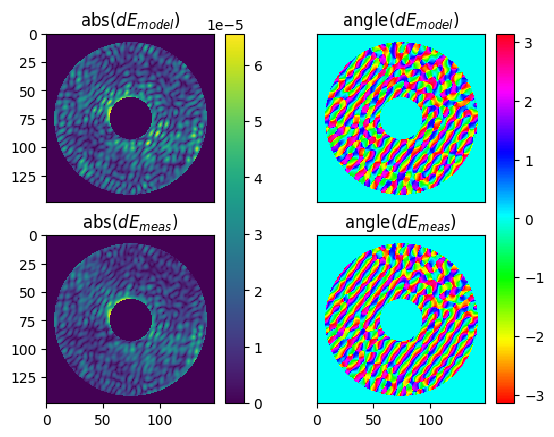

In [23]:
falco.wfsc.loop(mp, out)
misc.save_pickle('results/' + mp.runLabel + f'_mp_{date}.pkl', mp)
misc.save_pickle('results/' + mp.runLabel + f'_out_{date}.pkl', out)

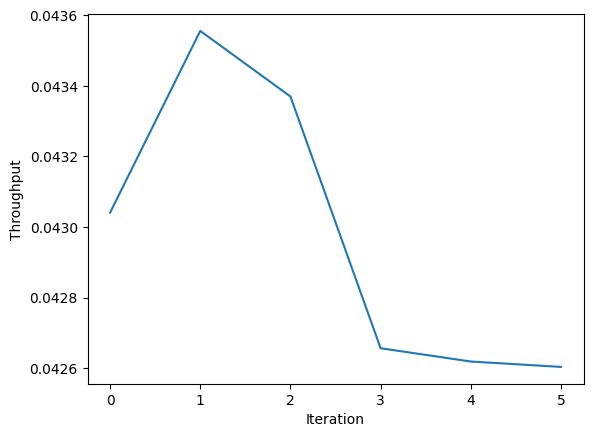

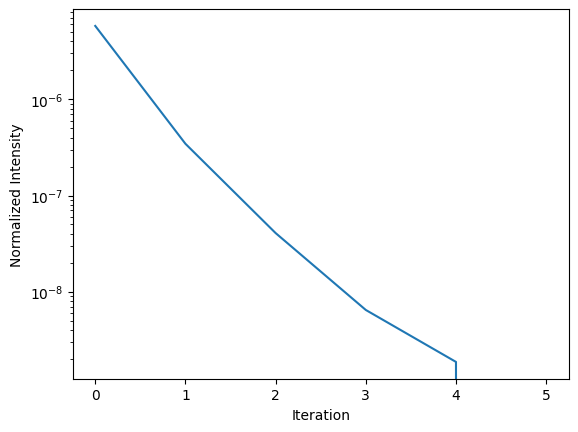

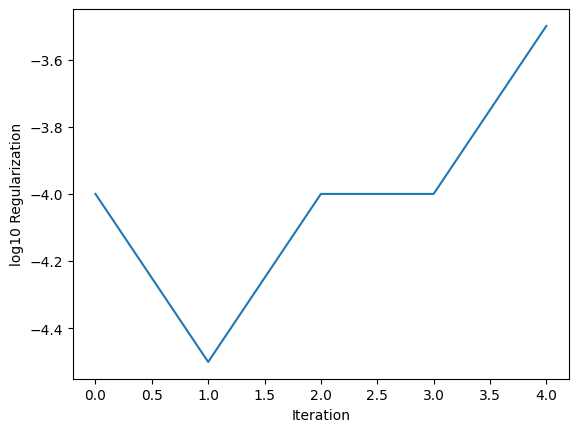

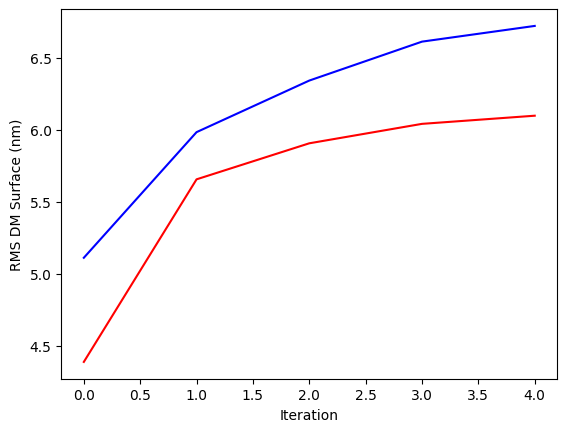

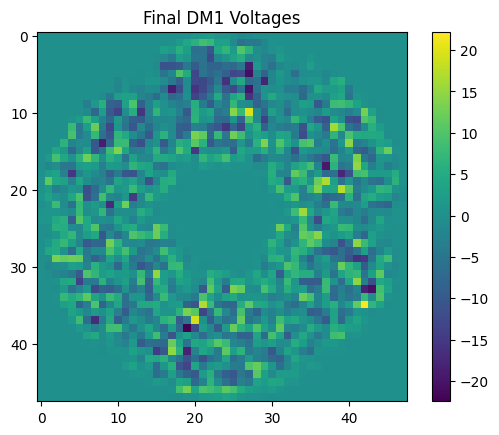

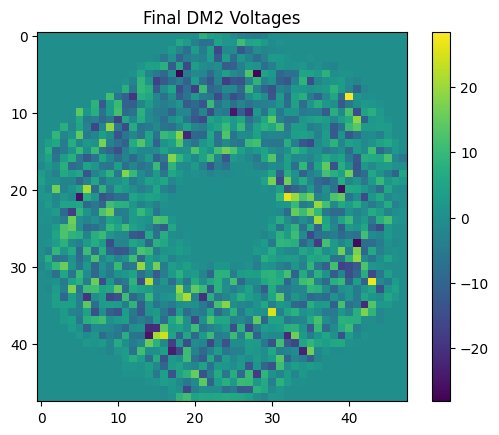

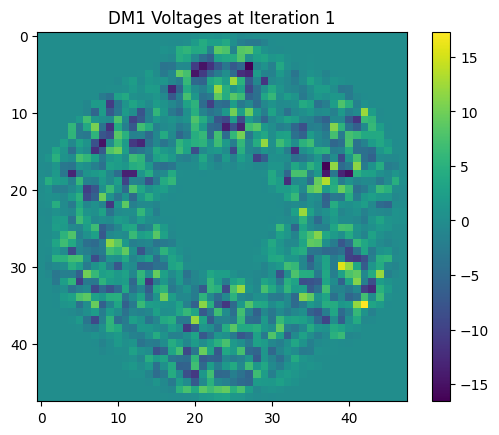

In [9]:
falco.plot.plot_trial_output(out)